In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# import the model
from sklearn.linear_model import LogisticRegression

# import the metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder


C:\ProgramData\Anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
# show all columns
pd.set_option('display.max_columns', None)

# Read in the data

Read in the data in the two files using the read_csv function from the pandas library. Merge the two data frames into a single dataframe.

In [3]:
#data_folder = "MLB data"

In [4]:
# Read the two dataframes and merge them
pitches = pd.concat([pd.read_csv("pitches.csv"),  pd.read_csv("2019_pitches.csv")])

# Make a copy of the dataframe
# pitches_cp = pitches.copy()

# Data Exploration and Cleaning

Use the head() function to display the first few rows of the data.

In [5]:
pitches.head()

,px,pz,start_speed,end_speed,spin_rate,spin_dir,break_angle,break_length,break_y,ax,ay,az,sz_bot,sz_top,type_confidence,vx0,vy0,vz0,x,x0,y,y0,z0,pfx_x,pfx_z,nasty,zone,code,type,pitch_type,event_num,b_score,ab_id,b_count,s_count,outs,pitch_num,on_1b,on_2b,on_3b
0,0.416,2.963,92.9,84.1,2305.052,159.235,-25.0,3.2,23.7,7.665,34.685,-11.960,1.72,3.56,2.0,-6.409,-136.065,-3.995,101.14,2.280,158.78,50.0,5.302,4.16,10.93,55.0,3.0,C,S,FF,3,0.0,2.015000e+09,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,-0.191,2.347,92.8,84.1,2689.935,151.402,-40.7,3.4,23.7,12.043,34.225,-10.085,1.72,3.56,2.0,-8.411,-135.690,-5.980,124.28,2.119,175.41,50.0,5.307,6.57,12.00,31.0,5.0,S,S,FF,4,0.0,2.015000e+09,0.0,1.0,0.0,2.0,0.0,0.0,0.0
2,-0.518,3.284,94.1,85.2,2647.972,145.125,-43.7,3.7,23.7,14.368,35.276,-11.560,1.72,3.56,2.0,-9.802,-137.668,-3.337,136.74,2.127,150.11,50.0,5.313,7.61,10.88,49.0,1.0,F,S,FF,5,0.0,2.015000e+09,0.0,2.0,0.0,3.0,0.0,0.0,0.0
3,-0.641,1.221,91.0,84.0,1289.59,169.751,-1.3,5.0,23.8,2.104,28.354,-20.540,1.74,3.35,2.0,-8.071,-133.005,-6.567,109.685636,2.279,187.463482,50.0,5.210,1.17,6.45,41.0,13.0,B,B,FF,6,0.0,2.015000e+09,0.0,2.0,0.0,4.0,0.0,0.0,0.0
4,-1.821,2.083,75.4,69.6,1374.569,280.671,18.4,12.0,23.8,-10.280,21.774,-34.111,1.72,3.56,2.0,-6.309,-110.409,0.325,146.527525,2.179,177.242829,50.0,5.557,-8.43,-1.65,18.0,13.0,B,B,CU,7,0.0,2.015000e+09,1.0,2.0,0.0,5.0,0.0,0.0,0.0


Check the number of rows and columns in the data using the shape attribute.

In [6]:
print(pitches.shape)

(3595944, 40)


The data contains 3,595,944 rows and 40 columns

Check the column names and their data types using the info() function.

In [7]:
pitches.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3595944 entries, 0 to 728789
Data columns (total 40 columns):
 #   Column           Dtype  
---  ------           -----  
 0   px               float64
 1   pz               float64
 2   start_speed      float64
 3   end_speed        float64
 4   spin_rate        object 
 5   spin_dir         object 
 6   break_angle      float64
 7   break_length     float64
 8   break_y          float64
 9   ax               float64
 10  ay               float64
 11  az               float64
 12  sz_bot           float64
 13  sz_top           float64
 14  type_confidence  object 
 15  vx0              float64
 16  vy0              float64
 17  vz0              float64
 18  x                object 
 19  x0               float64
 20  y                object 
 21  y0               float64
 22  z0               float64
 23  pfx_x            float64
 24  pfx_z            float64
 25  nasty            float64
 26  zone             object 
 27  code         

Use the describe() function to view the summary statistics for the numeric columns. The describe() function is a useful tool for getting a high-level understanding of the data. It displays summary statistics for the numeric columns. It is also useful for identifying columns that contain missing values. The count row indicates the number of non-missing values in each column. If the count for a column is less than the number of rows in the data frame, then the column contains missing values. This function only returns summary statistics for the numeric columns by default.

In [8]:
pitches.describe()

,px,pz,start_speed,end_speed,break_angle,break_length,break_y,ax,ay,az,sz_bot,sz_top,vx0,vy0,vz0,x0,y0,z0,pfx_x,pfx_z,nasty,event_num,b_score,ab_id,b_count,s_count,outs,pitch_num,on_1b,on_2b,on_3b
count,3.575126e+06,3.575126e+06,3.575201e+06,3.575201e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.593861e+06,3.593861e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575126e+06,3.575173e+06,3.575173e+06,2.852965e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06,3.595944e+06
mean,1.304349e-02,2.253077e+00,8.844150e+01,8.143658e+01,8.763153e+00,6.600131e+00,2.385384e+01,-2.347376e+00,2.631064e+01,-2.292439e+01,1.574012e+00,3.421969e+00,2.285928e+00,-1.288708e+02,-4.379455e+00,-7.099970e-01,5.000000e+01,5.805255e+00,-1.157098e+00,4.959819e+00,4.442669e+01,3.021875e+02,2.295302e+00,2.017110e+09,8.724368e-01,7.381505e-01,9.823223e-01,2.900839e+00,2.406592e-01,1.483394e-01,7.650814e-02
std,8.849812e-01,9.497987e-01,5.997268e+00,5.354790e+00,2.327334e+01,1.189698e+02,9.340191e-02,1.065440e+01,4.079187e+00,8.837869e+00,1.478634e-01,2.133456e-01,5.991687e+00,8.700152e+00,3.054391e+00,1.736984e+00,2.614476e-14,4.591230e-01,6.224788e+00,5.161875e+00,1.683662e+01,1.874530e+02,2.586394e+00,1.412550e+06,9.614766e-01,8.116935e-01,8.174988e-01,1.729870e+00,4.274838e-01,3.554361e-01,2.658095e-01
min,-1.054333e+01,-5.183664e+00,3.390000e+01,3.240000e+01,-9.000000e+01,1.000000e-01,2.280000e+01,-5.929009e+01,-5.243748e-01,-7.717142e+01,-7.921409e+00,-1.849129e+00,-2.486900e+01,-1.533620e+02,-1.992000e+01,-9.556000e+00,5.000000e+01,-1.941000e+00,-2.809165e+01,-7.020600e+01,0.000000e+00,3.000000e+00,0.000000e+00,2.015000e+09,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,-5.806576e-01,1.645000e+00,8.430000e+01,7.800000e+01,-8.100000e+00,4.300000e+00,2.380000e+01,-1.127200e+01,2.330500e+01,-2.888300e+01,1.500000e+00,3.290000e+00,-2.199113e+00,-1.355600e+02,-6.460000e+00,-1.953000e+00,5.000000e+01,5.552413e+00,-6.430000e+00,2.060000e+00,3.200000e+01,1.440000e+02,0.000000e+00,2.016051e+09,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.000000e-02,2.258000e+00,8.980000e+01,8.260000e+01,1.120000e+01,6.000000e+00,2.380000e+01,-3.060000e+00,2.629200e+01,-2.179398e+01,1.580000e+00,3.420000e+00,4.011761e+00,-1.307900e+02,-4.553696e+00,-1.340000e+00,5.000000e+01,5.831000e+00,-1.830332e+00,5.982645e+00,4.400000e+01,2.910000e+02,2.000000e+00,2.017097e+09,1.000000e+00,1.000000e+00,1.000000e+00,3.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,6.106459e-01,2.865172e+00,9.300000e+01,8.550000e+01,2.800000e+01,8.100000e+00,2.390000e+01,5.846172e+00,2.916668e+01,-1.582200e+01,1.660000e+00,3.560000e+00,6.640000e+00,-1.229230e+02,-2.457000e+00,8.400000e-01,5.000000e+01,6.099000e+00,3.758310e+00,8.890000e+00,5.600000e+01,4.450000e+02,4.000000e+00,2.018142e+09,1.000000e+00,1.000000e+00,2.000000e+00,4.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,1.295291e+01,1.488624e+01,1.050000e+02,9.690000e+01,2.694000e+02,2.248893e+05,3.640000e+01,4.097800e+01,5.405700e+01,3.039000e+01,1.069854e+01,1.054815e+01,2.515000e+01,-4.755200e+01,2.781500e+01,9.676000e+00,5.000000e+01,1.059600e+01,2.202000e+01,3.412000e+01,1.000000e+02,1.336000e+03,2.500000e+01,2.019185e+09,4.000000e+00,2.000000e+00,2.000000e+00,2.100000e+01,1.000000e+00,1.000000e+00,1.000000e+00


It is important to understand the data types of the columns. The data types will determine what kinds of operations you can perform on the columns. For example, you can only perform arithmetic operations on numeric columns. You can use the select_dtypes() function to select columns of a specific data type from a data frame. We will use this function to select the object columns and then use the describe() function to view the summary statistics for the object columns.

In [9]:
pitches.select_dtypes(include=['object']).describe()

,spin_rate,spin_dir,type_confidence,x,y,zone,code,type,pitch_type
count,3575126,3575126,3575126.0,3595944.0,3595944.0,3575126,3590225,3595944,3575126
unique,1687548,335092,1110.0,47342.0,39686.0,14,20,16,18
top,placeholder,placeholder,2.0,1.0,0.0,placeholder,B,S,FF
freq,722161,722161,1711162.0,10654.0,12577.0,722161,1200547,1384615,1276362


The data seems to contain some missing values since the count for some columns is less than the number of rows in the data frame. This is something we will need to deal with later.

Next, let's drop the columns that we will not be using in our analysis. Let's start by viweing the column names.

In [10]:
pitches.columns

Index(['px', 'pz', 'start_speed', 'end_speed', 'spin_rate', 'spin_dir',
       'break_angle', 'break_length', 'break_y', 'ax', 'ay', 'az', 'sz_bot',
       'sz_top', 'type_confidence', 'vx0', 'vy0', 'vz0', 'x', 'x0', 'y', 'y0',
       'z0', 'pfx_x', 'pfx_z', 'nasty', 'zone', 'code', 'type', 'pitch_type',
       'event_num', 'b_score', 'ab_id', 'b_count', 's_count', 'outs',
       'pitch_num', 'on_1b', 'on_2b', 'on_3b'],
      dtype='object')

Since the following columns are not relevant to our analysis, we will drop them from the data frame.
- b_count
- s_count
- outs
- pitch_num
- on_1b
- on_2b
- on_3b
- event_num
- b_score
- ab_id
- type_confidence
- type
- code

In [11]:
pitches.drop(['b_count', 's_count', 'outs',
       'pitch_num', 'on_1b', 'on_2b', 'on_3b', 
       'event_num', 'b_score', 'ab_id', 'type_confidence', 
       'type', 'code'], axis=1, inplace=True)

Columns like spin_rate, spin_dir, and zone which should be numeric columns are of type object. This is because they contain missing values and non-numeric values. We will need to convert these columns to numeric columns. Lets start by visualising the non numeric values in these columns.

In [12]:
def isnumber(x):
    try:
        float(x)
        return True
    except:
        return False

# visualise non-numerical values in the selected columns
for col in pitches.select_dtypes(include=['object']).columns:
    print(col, '\n')
    # count non-numerical values
    print(pitches[col][pitches[col].apply(lambda x: not isnumber(x))].value_counts(), '\n')

spin_rate 

placeholder    722161
Name: spin_rate, dtype: int64 

spin_dir 

placeholder    722161
Name: spin_dir, dtype: int64 

x 

None    4759
Name: x, dtype: int64 

y 

None    4759
Name: y, dtype: int64 

zone 

placeholder    722161
Name: zone, dtype: int64 

pitch_type 

FF    1276362
SL     578258
FT     399027
CH     372728
CU     298557
SI     297865
FC     196095
KC      81808
FS      54243
KN      11460
IN       6197
EP        864
FO        846
PO        628
SC        113
UN         57
FA          9
AB          9
Name: pitch_type, dtype: int64 



Plot heatmap to visualise where "placeholder" values are in the data.

<AxesSubplot:>

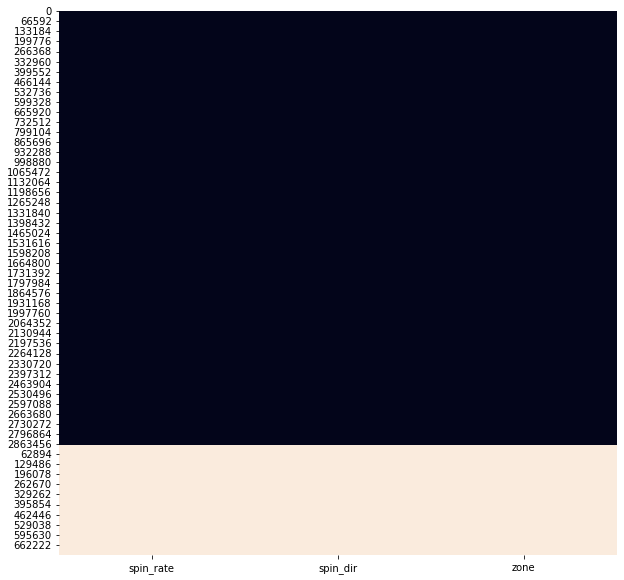

In [13]:
# plot heatmap where either spin_dir, spin_rate, or zone is equal to "placeholder"
plt.figure(figsize=(10, 10))
sns.heatmap(pitches[["spin_rate", "spin_dir", "zone"]].isin(['placeholder']).astype(int), cbar=False)


From the heatmap, it can be seen that the dataponits with value "placeholder" in `spin_dir`, `spin_rate`, `zone` are the same. We will drop these rows from the data frame.

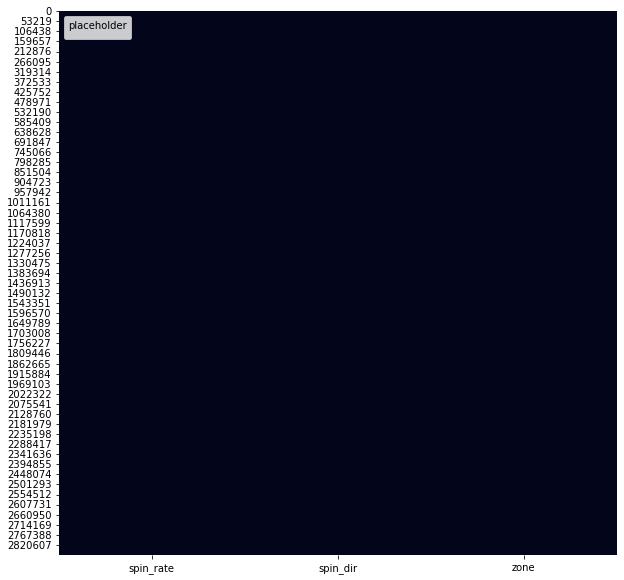

In [14]:
pitches = pitches[(pitches["zone"] != "placeholder")]

# let's visualise again
plt.figure(figsize=(10, 10))
sns.heatmap(pitches[["spin_rate", "spin_dir", "zone"]].isin(['placeholder']).astype(int), cbar=False)
# add legend to show what the colors mean
plt.legend(title="placeholder", loc="upper left", labels=["not placeholder"])


Next, let's convert the object columns except the to numeric columns. We will use the to_numeric() function to convert the columns to numeric columns. The errors='coerce' argument will convert the non-numeric values to NaN.

In [15]:
# convert the columns to numeric
pitches[["zone", "spin_dir", "spin_rate"]] = pitches[["zone", "spin_dir", "spin_rate"]].apply(pd.to_numeric)

Next, let's handle the missing data. We will use the isnull() function to check for missing values in the data frame. The isnull() function returns a boolean data frame that has True in cells that contain missing values and False in cells that do not contain missing values. We can use the sum() function to count the number of missing values in each column.

In [16]:
pitches.isnull().sum()

px              20818
pz              20818
start_speed     20743
end_speed       20743
spin_rate       20818
spin_dir        20818
break_angle     20818
break_length    20818
break_y         20818
ax              20818
ay              20818
az              20818
sz_bot           2083
sz_top           2083
vx0             20818
vy0             20818
vz0             20818
x                   0
x0              20818
y                   0
y0              20818
z0              20818
pfx_x           20771
pfx_z           20771
nasty           20818
zone            20818
pitch_type      20818
dtype: int64

Let's plot the missing values using a heatmap.

<AxesSubplot:>

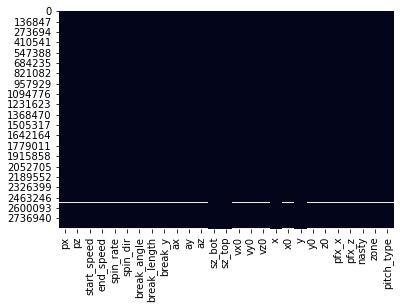

In [17]:
sns.heatmap(pitches.isnull(), cbar=False)

Luckily, the missing rows seem to be same for all the columns. We will drop these rows from the data frame.

In [18]:
pitches.dropna(inplace=True)

# let's confirm that there are no more missing values
pitches.isnull().sum()

px              0
pz              0
start_speed     0
end_speed       0
spin_rate       0
spin_dir        0
break_angle     0
break_length    0
break_y         0
ax              0
ay              0
az              0
sz_bot          0
sz_top          0
vx0             0
vy0             0
vz0             0
x               0
x0              0
y               0
y0              0
z0              0
pfx_x           0
pfx_z           0
nasty           0
zone            0
pitch_type      0
dtype: int64

Now we have a clean data frame with no missing values. Let's check the shape of the data frame.

In [19]:
print(pitches.shape)

(2852965, 27)


We have 2,852,965 rows and 27 columns in the data frame.

# Data Analysis

Let's start by visualising the distribution of the target variable. We will use the value_counts() function to count the number of rows for each value of the target variable. We will then use the plot() function to plot the counts.

In [20]:
print(f"Number of unique pitch types is {pitches['pitch_type'].nunique()}")

pitches[["pitch_type"]].value_counts()


Number of unique pitch types is 18


pitch_type
FF            1014877
SL             450578
FT             337983
CH             292789
SI             242504
CU             234391
FC             149756
KC              66484
FS              43705
KN              11260
IN               6197
EP                815
FO                810
PO                628
SC                113
UN                 57
FA                  9
AB                  9
dtype: int64

The following are the Pitch Types generated:
- AB Automatic Ball
- AS Automatic Strike
- CH Change-up
- CU Curveball
- EP Eephus
- FC Cutter
- FF Four-Seam Fastball
- FO Forkball
- FS Splitter
- FT Two-Seam Fastball (synonymous with SI)
- GY Gyroball
- IN Intentional Ball
- KC Knuckle Curve
- KN Knuckleball
- NP No Pitch
- PO Pitchout
- SC Screwball
- SI Sinker (synonymous with FT)
- SL Slider
- UN Unknown

Let's visualise this using a bar plot.

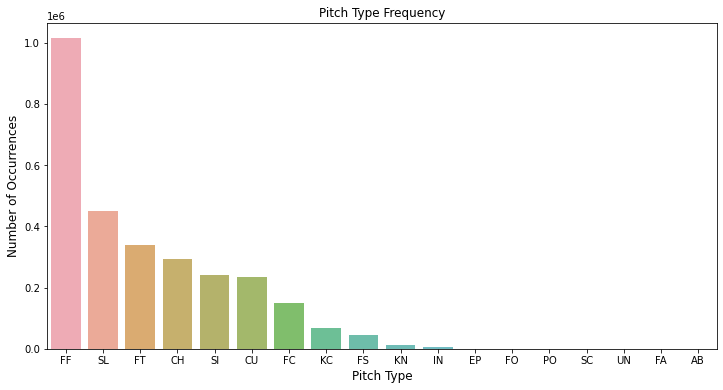

In [21]:
# plot the pitch types
count = pitches["pitch_type"].value_counts()
plt.figure(figsize=(12,6))
sns.barplot(x=count.index, y=count.values, alpha=0.8)
plt.title("Pitch Type Frequency")
plt.ylabel("Number of Occurrences", fontsize=12)
plt.xlabel("Pitch Type", fontsize=12)
plt.show()


The target variable is imbalanced. There are over 1 million four-seam fastballs (FF) while some pitches like eephus (EP) and knuckleball (KN) are less than 1000. Since the difference in the number of pitches is large, let's only consider the top 10 pitches.

Let's visualise the top 10 pitches using a bar plot.

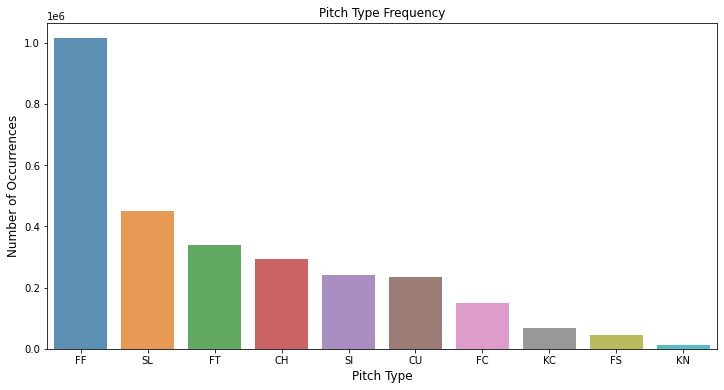

In [22]:
# plot the pitch types
count = pitches["pitch_type"].value_counts()[:10]
plt.figure(figsize=(12,6))
sns.barplot(x=count.index, y=count.values, alpha=0.8)
plt.title("Pitch Type Frequency")
plt.ylabel("Number of Occurrences", fontsize=12)
plt.xlabel("Pitch Type", fontsize=12)
plt.show()


The top 10 pitches are:
- Four-seam Fastball (FF)
- Slider (SL)
- Two-seam Fastball (FT)
- Changeup (CH)
- Sinker (SI)
- Curveball (CU)
- Cutter (FC)
- Knuckle Curve (KC)
- Split Finger (FS)
- Knuckleball (KN)

These are the pitches we will be analysing in this project.

The pitch types are still imbalanced. We will need to balance the data before training our model.

Let's drop the rows that contain pitches that are not in the top 10 pitches.

In [23]:
# only keep the top 10 pitch types
pitches = pitches[pitches["pitch_type"].isin(count.index)]

# confirm that we only have the top 10 pitch types
pitches["pitch_type"].value_counts()

FF    1014877
SL     450578
FT     337983
CH     292789
SI     242504
CU     234391
FC     149756
KC      66484
FS      43705
KN      11260
Name: pitch_type, dtype: int64

Let's visualise the distribution of the pitches using a pie chart

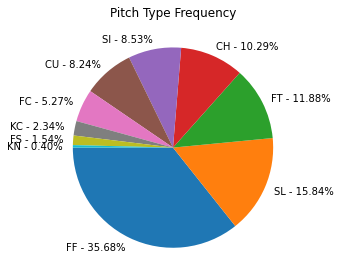

In [24]:
# plot pie chart for pitch types
# plt.figure(figsize=(12,6))
labels = pitches["pitch_type"].value_counts().index
pct = pitches["pitch_type"].value_counts(
    normalize=True).values * 100

labels = [f"{l} - {p:.2f}%" for l, p in zip(labels, pct)]

patches, text = plt.pie(pitches["pitch_type"].value_counts(), labels=labels, startangle=180, 
        textprops={'fontsize': 10},
                )
plt.title("Pitch Type Frequency")
plt.tight_layout()
plt.savefig("pitch_type_frequency.png")
plt.show()

In [25]:
# sns.pairplot(pitches, hue="pitch_type")

In [26]:
#pitches.corr(numeric_only=True)

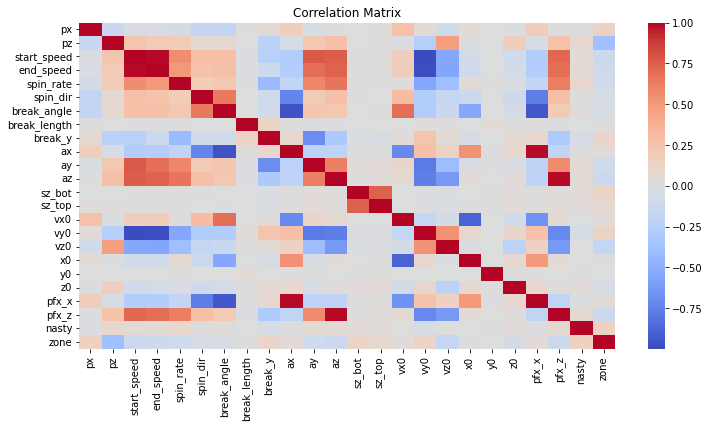

In [27]:
# plot the correlation matrix
plt.figure(figsize=(12,6))
sns.heatmap(pitches.corr(), annot=False, cmap="coolwarm")
plt.title("Correlation Matrix")
plt.savefig("correlation_matrix.png")
plt.show()

In [28]:
pitches.describe()

,px,pz,start_speed,end_speed,spin_rate,spin_dir,break_angle,break_length,break_y,ax,ay,az,sz_bot,sz_top,vx0,vy0,vz0,x0,y0,z0,pfx_x,pfx_z,nasty,zone
count,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06,2.844327e+06
mean,7.090751e-03,2.249435e+00,8.842361e+01,8.140187e+01,1.731845e+03,1.802063e+02,5.848553e+00,6.593334e+00,2.381692e+01,-2.307689e+00,2.651131e+01,-2.277821e+01,1.566497e+00,3.435331e+00,2.283381e+00,-1.289177e+02,-4.436352e+00,-7.184169e-01,5.000000e+01,5.812095e+00,-1.138048e+00,5.042507e+00,4.453080e+01,9.814890e+00
std,8.687352e-01,9.384867e-01,5.951917e+00,5.303512e+00,6.831986e+02,6.746652e+01,2.445821e+01,1.333725e+02,6.441319e-02,1.075012e+01,4.123944e+00,8.872291e+00,1.552282e-01,2.173137e-01,5.989037e+00,8.634457e+00,3.052578e+00,1.727535e+00,2.930425e-14,4.557939e-01,6.278027e+00,5.187490e+00,1.671456e+01,4.065008e+00
min,-1.054333e+01,-4.810000e+00,4.510000e+01,3.980000e+01,1.214000e+00,-2.000000e-03,-9.000000e+01,1.000000e-01,2.330000e+01,-5.929009e+01,-5.243748e-01,-7.717142e+01,-7.921409e+00,-1.849129e+00,-2.486900e+01,-1.533620e+02,-1.977060e+01,-8.835000e+00,5.000000e+01,-1.544000e+00,-2.809165e+01,-7.020600e+01,0.000000e+00,1.000000e+00
25%,-5.894944e-01,1.649000e+00,8.430000e+01,7.800000e+01,1.238948e+03,1.370710e+02,-1.190000e+01,4.300000e+00,2.380000e+01,-1.130500e+01,2.347910e+01,-2.872884e+01,1.483871e+00,3.300000e+00,-2.077000e+00,-1.355230e+02,-6.518824e+00,-1.954147e+00,5.000000e+01,5.563317e+00,-6.454534e+00,2.150000e+00,3.200000e+01,6.000000e+00
50%,1.300000e-02,2.256834e+00,8.980000e+01,8.260000e+01,1.867825e+03,1.958490e+02,6.800000e+00,6.000000e+00,2.380000e+01,-3.139000e+00,2.648800e+01,-2.158000e+01,1.570000e+00,3.440000e+00,3.994933e+00,-1.308647e+02,-4.614000e+00,-1.333446e+00,5.000000e+01,5.841000e+00,-1.870239e+00,6.080604e+00,4.400000e+01,1.100000e+01
75%,6.073703e-01,2.858291e+00,9.300000e+01,8.540000e+01,2.248466e+03,2.252590e+02,2.710000e+01,8.000000e+00,2.390000e+01,6.007232e+00,2.939300e+01,-1.572900e+01,1.658758e+00,3.578646e+00,6.626000e+00,-1.230064e+02,-2.507928e+00,7.790000e-01,5.000000e+01,6.102884e+00,3.870000e+00,8.950000e+00,5.600000e+01,1.300000e+01
max,1.295291e+01,1.248854e+01,1.050000e+02,9.690000e+01,6.539259e+03,3.600010e+02,2.694000e+02,2.248893e+05,3.640000e+01,4.097800e+01,5.405700e+01,2.230520e+01,1.069854e+01,1.054815e+01,2.515000e+01,-6.274138e+01,2.781500e+01,9.676000e+00,5.000000e+01,1.032464e+01,2.202000e+01,3.316048e+01,1.000000e+02,1.400000e+01


## Train Test Split

In [29]:

le = LabelEncoder()

y = le.fit_transform(pitches["pitch_type"])

X = pitches.drop("pitch_type", axis=1)

X.head()

,px,pz,start_speed,end_speed,spin_rate,spin_dir,break_angle,break_length,break_y,ax,ay,az,sz_bot,sz_top,vx0,vy0,vz0,x,x0,y,y0,z0,pfx_x,pfx_z,nasty,zone
0,0.416,2.963,92.9,84.1,2305.052,159.235,-25.0,3.2,23.7,7.665,34.685,-11.960,1.72,3.56,-6.409,-136.065,-3.995,101.14,2.280,158.78,50.0,5.302,4.16,10.93,55.0,3.0
1,-0.191,2.347,92.8,84.1,2689.935,151.402,-40.7,3.4,23.7,12.043,34.225,-10.085,1.72,3.56,-8.411,-135.690,-5.980,124.28,2.119,175.41,50.0,5.307,6.57,12.00,31.0,5.0
2,-0.518,3.284,94.1,85.2,2647.972,145.125,-43.7,3.7,23.7,14.368,35.276,-11.560,1.72,3.56,-9.802,-137.668,-3.337,136.74,2.127,150.11,50.0,5.313,7.61,10.88,49.0,1.0
3,-0.641,1.221,91.0,84.0,1289.590,169.751,-1.3,5.0,23.8,2.104,28.354,-20.540,1.74,3.35,-8.071,-133.005,-6.567,109.685636,2.279,187.463482,50.0,5.210,1.17,6.45,41.0,13.0
4,-1.821,2.083,75.4,69.6,1374.569,280.671,18.4,12.0,23.8,-10.280,21.774,-34.111,1.72,3.56,-6.309,-110.409,0.325,146.527525,2.179,177.242829,50.0,5.557,-8.43,-1.65,18.0,13.0


In [30]:


X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2,  # 20% test, 80% train
                                                    random_state=42,
                                                    stratify=y)


## Train Logistic Regression Model
A logistic regression model is used as a baseline model to compare with the neural network model. The initial model is trained with the default parameters with no feature engineering. The model is then tuned by adding features and adjusting the regularization parameter. The model is then evaluated on the test set.

In [31]:
# instantiate the model
logreg = LogisticRegression(multi_class="multinomial", solver="lbfgs")

# fit the model
logreg.fit(X_train, y_train)

# predict the test set
y_pred = logreg.predict(X_test)

# print the accuracy score
print("Accuracy score: ", accuracy_score(y_test, y_pred))

# print the confusion matrix
print("Confusion matrix: \n", confusion_matrix(y_test, y_pred))

# print the classification report
print("Classification report: \n", classification_report(y_test, y_pred))

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy score:  0.5728906280213618
Confusion matrix: 
 [[ 26171   3027      1  15654      0   5750     16      0    826   7113]
 [  6608  19858     42   1221      0    569   4323      0   1994  12263]
 [   554    303      1   8983      0      1     25      0      0  20084]
 [  1685    209      1 195017      0    855      0      0     95   5113]
 [  3853    471      4   1152      0    506     20      0    113   2622]
 [  2851    436     11  55796      0   6338      0      0    277   1888]
 [  1140   6040     20    395      0    124   1842      0    463   3273]
 [   264    217      0    175      0     20    108      0     29   1439]
 [  3565    597      6  35936      0   5501      2      0   1399   1495]
 [  3697   4732     44   4387      0     63   1426      0    495  75272]]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification report: 
               precision    recall  f1-score   support

           0       0.52      0.45      0.48     58558
           1       0.55      0.42      0.48     46878
           2       0.01      0.00      0.00     29951
           3       0.61      0.96      0.75    202975
           4       0.00      0.00      0.00      8741
           5       0.32      0.09      0.15     67597
           6       0.24      0.14      0.17     13297
           7       0.00      0.00      0.00      2252
           8       0.25      0.03      0.05     48501
           9       0.58      0.84      0.68     90116

    accuracy                           0.57    568866
   macro avg       0.31      0.29      0.28    568866
weighted avg       0.47      0.57      0.49    568866



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


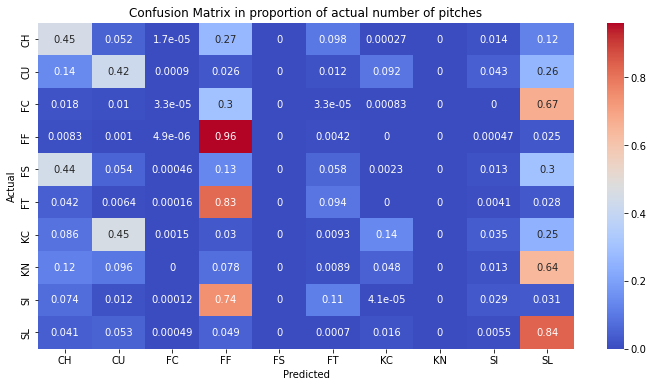

In [32]:
cf = confusion_matrix(y_test, y_pred)

# divide each element in the confusion matrix by the sum of the row
cf = cf.astype('float') / cf.sum(axis=1)[:, np.newaxis]


# plot confusion matrix
plt.figure(figsize=(12,6))
sns.heatmap(cf, annot=True, cmap="coolwarm")
plt.title("Confusion Matrix in proportion of actual number of pitches")
plt.xlabel("Predicted")
plt.ylabel("Actual")
# change the xticks and yticks
plt.xticks(np.arange(10) + 0.5, labels=le.classes_)
plt.yticks(np.arange(10) + 0.5, labels=le.classes_)
plt.savefig("confusion_matrix - logistic regression 1st fit.png")

plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


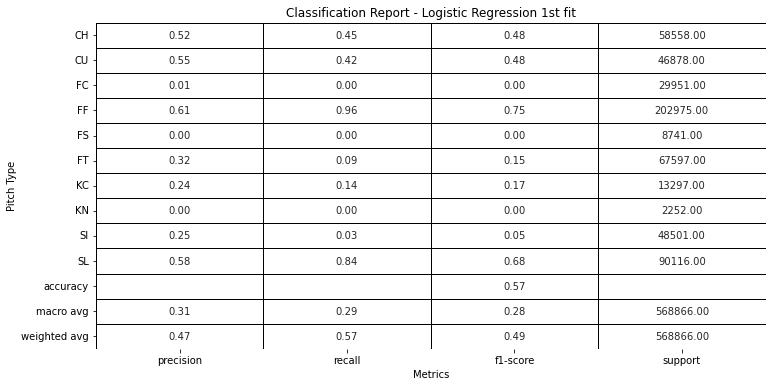

In [33]:
clr = classification_report(y_test, y_pred, output_dict=True)
# change the keys to the pitch types
clr = {le.classes_[int(k)] if k.isnumeric() else k : v for k, v in clr.items() }
clr = pd.DataFrame(clr)
clr["accuracy"] = [None,None,clr["accuracy"][0], None]
clr = clr.T


# plot classification report
plt.figure(figsize=(12,6))
sns.heatmap(clr.iloc[:, :], annot=True, cmap=["white", "white"], cbar=False, linewidths=0.5, linecolor="black", fmt=".2f")
plt.title("Classification Report - Logistic Regression 1st fit")
plt.xlabel("Metrics")
plt.ylabel("Pitch Type")
plt.savefig("classification_report - logistic regression 1st fit.png")


From the results, it can be seen that the imbalance in the dataset is affecting the model's performance. The model is predicting the majority classes FF and SL very well but is not predicting the minority classes very well. The model is predicting the minority classes as the majority classes. This is because the model is biased towards the majority classes. We will need to balance the data before training the model.

## Balance Data
To balance the data, we will use the SMOTE algorithm. SMOTE is an oversampling technique that generates synthetic data points for the minority classes. The SMOTE algorithm is implemented in the imblearn library. We will use the SMOTE algorithm to generate synthetic data points for the minority classes. We will then train the model on the balanced data and evaluate the model on the test set.


In [34]:
# install the library for imbalanced-learn
!pip install imbalanced-learn
!pip install imblearn

  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3
  Rolling back uninstall of numpy
  Moving to c:\users\oo343\appdata\roaming\python\python39\scripts\f2py.exe
   from C:\Users\oo343\AppData\Local\Temp\pip-uninstall-8blu9zn0\f2py.exe
  Moving to c:\users\oo343\appdata\roaming\python\python39\site-packages\numpy-1.24.3.dist-info\
   from C:\Users\oo343\AppData\Roaming\Python\Python39\site-packages\~umpy-1.24.3.dist-info
  Moving to c:\users\oo343\appdata\roaming\python\python39\site-packages\numpy\
   from C:\Users\oo343\AppData\Roaming\Python\Python39\site-packages\~umpy


ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\ProgramData\\Anaconda3\\Lib\\site-packages\\numpy\\core\\_multiarray_tests.cp39-win_amd64.pyd'
Consider using the `--user` option or check the permissions.



  Using cached numpy-1.22.4-cp39-cp39-win_amd64.whl (14.7 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.3
    Uninstalling numpy-1.24.3:
      Successfully uninstalled numpy-1.24.3
  Rolling back uninstall of numpy
  Moving to c:\users\oo343\appdata\roaming\python\python39\scripts\f2py.exe
   from C:\Users\oo343\AppData\Local\Temp\pip-uninstall-3_la4863\f2py.exe
  Moving to c:\users\oo343\appdata\roaming\python\python39\site-packages\numpy-1.24.3.dist-info\
   from C:\Users\oo343\AppData\Roaming\Python\Python39\site-packages\~umpy-1.24.3.dist-info
  Moving to c:\users\oo343\appdata\roaming\python\python39\site-packages\numpy\
   from C:\Users\oo343\AppData\Roaming\Python\Python39\site-packages\~umpy


ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\ProgramData\\Anaconda3\\Lib\\site-packages\\numpy\\core\\_multiarray_tests.cp39-win_amd64.pyd'
Consider using the `--user` option or check the permissions.



In [35]:
# import SMOTE
from imblearn.over_sampling import SMOTE

In [36]:
# instantiate SMOTE
sm = SMOTE(random_state=42)

# fit SMOTE on the training set
X_train_sm, y_train_sm = sm.fit_resample(X_train, y_train)

# print the shape of X_train and y_train
print("Shape of X_train before SMOTE: ", X_train.shape)
print("Shape of y_train before SMOTE: ", y_train.shape)
print("Shape of X_train after SMOTE: ", X_train_sm.shape)
print("Shape of y_train after SMOTE: ", y_train_sm.shape)


Shape of X_train before SMOTE:  (2275461, 26)
Shape of y_train before SMOTE:  (2275461,)
Shape of X_train after SMOTE:  (8119020, 26)
Shape of y_train after SMOTE:  (8119020,)


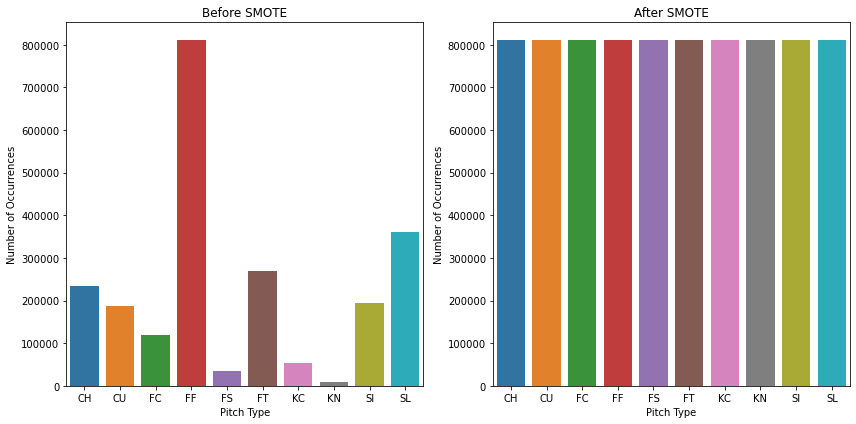

In [37]:
# make subplots of the pitch types in the training set before and after SMOTE
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,6))
y_train_val_counts = pd.DataFrame(y_train).reset_index().groupby(0).count()
sns.barplot(x=y_train_val_counts.index, y=y_train_val_counts.values.flatten(), ax=ax1)
ax1.set_xticklabels(le.classes_)
ax1.set_title("Before SMOTE")
ax1.set_xlabel("Pitch Type")
ax1.set_ylabel("Number of Occurrences")
y_train_sm_val_counts = pd.DataFrame(y_train_sm).reset_index().groupby(0).count()
sns.barplot(x=y_train_sm_val_counts.index, y=y_train_sm_val_counts.values.flatten(), ax=ax2)
ax2.set_xticklabels(le.classes_)
ax2.set_title("After SMOTE")
ax2.set_xlabel("Pitch Type")
ax2.set_ylabel("Number of Occurrences")
plt.tight_layout()
# plt.savefig("before and after SMOTE.png")
plt.show()

Now, let's train the model on the balanced data and evaluate the model on the test set.

In [38]:
# instantiate the model
logreg2 = LogisticRegression(multi_class="multinomial", solver="lbfgs")

# fit the model
logreg2.fit(X_train_sm, y_train_sm)

# predict the test set                                                               
y_pred2 = logreg2.predict(X_test)

# print the accuracy score
print("Accuracy score: ", accuracy_score(y_test, y_pred2))

# print the confusion matrix
print("Confusion matrix: \n", confusion_matrix(y_test, y_pred2))

# print the classification report
print("Classification report: \n", classification_report(y_test, y_pred2))



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy score:  0.47122169368533184
Confusion matrix: 
 [[ 18645   2109   4045   1121  14951   5144   1342   2193   7473   1535]
 [  4507  15169   1098    430   2263    345  10644   4926   1467   6029]
 [  1113    147  13493   2225   1533    125    106   2439    487   8283]
 [ 10537     77  20619 123129   7785  27992     97    610  11344    785]
 [  1435    304    328    172   3799    440    320    716    368    859]
 [  4589    158   5351  12523   6009  26943    292    292  11256    184]
 [   882   2542    232    145    193     71   6029   1465    299   1439]
 [   172     96    150      8    135      8    189    921     74    499]
 [  4891    301   3826   8195   5097  13183    434    274  12077    223]
 [  2024   3943  14025    463   4474     68   3544  13013    705  47857]]
Classification report: 
               precision    recall  f1-score   support

           0       0.38      0.32      0.35     58558
           1       0.61      0.32      0.42     46878
           2       0.21 

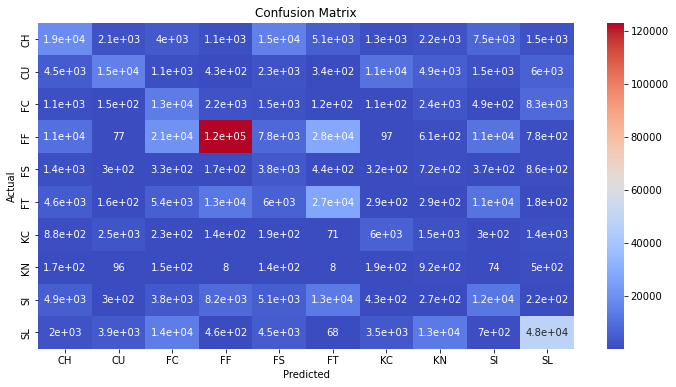

In [39]:

cf = confusion_matrix(y_test, y_pred2)

# divide each element in the confusion matrix by the sum of the row
# cf = cf.astype('float') / cf.sum(axis=1)[:, np.newaxis]


# plot confusion matrix
plt.figure(figsize=(12,6))
sns.heatmap(cf, annot=True, cmap="coolwarm")
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
# change the xticks and yticks
plt.xticks(np.arange(10) + 0.5, labels=le.classes_)
plt.yticks(np.arange(10) + 0.5, labels=le.classes_)
plt.savefig("confusion_matrix - logistic regression 2nd fit (oversampled data).png")

plt.show()


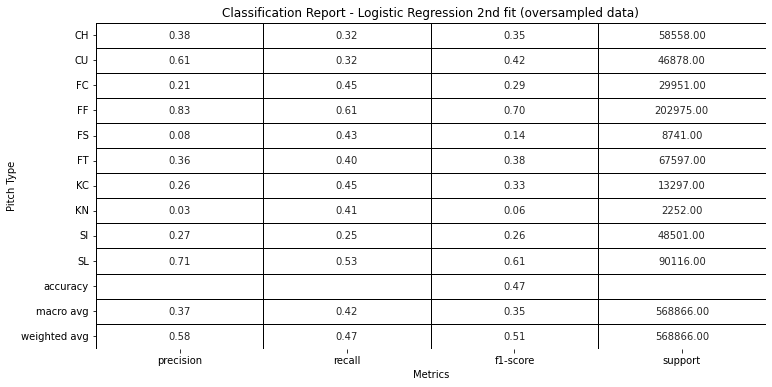

In [40]:
clr = classification_report(y_test, y_pred2, output_dict=True)
# change the keys to the pitch types
clr = {le.classes_[int(k)] if k.isnumeric() else k : v for k, v in clr.items() }
clr = pd.DataFrame(clr)
clr["accuracy"] = [None,None,clr["accuracy"][0], None]
clr = clr.T

# plot classification report
plt.figure(figsize=(12,6))
sns.heatmap(clr.iloc[:, :], annot=True, cmap=["white", "white"], cbar=False, linewidths=0.5, linecolor="black", fmt=".2f")
plt.title("Classification Report - Logistic Regression 2nd fit (oversampled data)")
plt.xlabel("Metrics")
plt.ylabel("Pitch Type")
plt.savefig("classification_report - logistic regression 2nd fit (oversampled data).png")



Let's try undersampling the data. We will use the RandomUnderSampler algorithm to undersample the majority classes. The RandomUnderSampler algorithm is implemented in the imblearn library. We will then train the model on the balanced data and evaluate the model on the test set.

In [41]:
# import the random undersampler
from imblearn.under_sampling import RandomUnderSampler

# instantiate the random undersampler
rus = RandomUnderSampler(random_state=42)

# fit the random undersampler to the training data
X_train_rus, y_train_rus = rus.fit_resample(X_train, y_train)

# print the shape of X_train and y_train

print("Shape of X_train before random undersampling: ", X_train.shape)
print("Shape of y_train before random undersampling: ", y_train.shape)
print("Shape of X_train after random undersampling: ", X_train_rus.shape)
print("Shape of y_train after random undersampling: ", y_train_rus.shape)

Shape of X_train before random undersampling:  (2275461, 26)
Shape of y_train before random undersampling:  (2275461,)
Shape of X_train after random undersampling:  (90080, 26)
Shape of y_train after random undersampling:  (90080,)


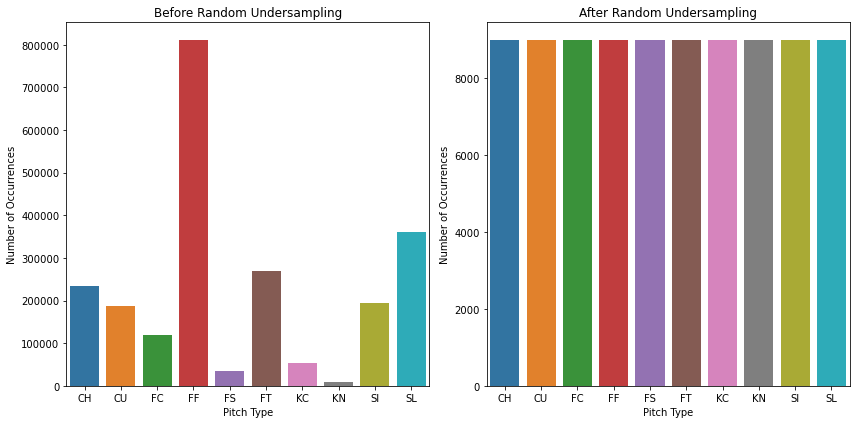

In [42]:
# make subplots of the pitch types in the training set before and after random undersampling
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,6))
y_train_val_counts = pd.DataFrame(y_train).reset_index().groupby(0).count()
sns.barplot(x=y_train_val_counts.index, y=y_train_val_counts.values.flatten(), ax=ax1)
ax1.set_xticklabels(le.classes_)
ax1.set_title("Before Random Undersampling")
ax1.set_xlabel("Pitch Type")
ax1.set_ylabel("Number of Occurrences")
y_train_rus_val_counts = pd.DataFrame(y_train_rus).reset_index().groupby(0).count()
sns.barplot(x=y_train_rus_val_counts.index, y=y_train_rus_val_counts.values.flatten(), ax=ax2)
ax2.set_xticklabels(le.classes_)
ax2.set_title("After Random Undersampling")
ax2.set_xlabel("Pitch Type")
ax2.set_ylabel("Number of Occurrences")
plt.tight_layout()

plt.show()


Now let's train the model on the undersampled data and evaluate the model on the test set.

In [43]:
# instantiate the model
logreg3 = LogisticRegression(multi_class="multinomial", solver="lbfgs")

# fit the model
logreg3.fit(X_train_rus, y_train_rus)

# predict the test set
y_pred3 = logreg3.predict(X_test)

# print the accuracy score
print("Accuracy score: ", accuracy_score(y_test, y_pred3))

# print the confusion matrix
print("Confusion matrix: \n", confusion_matrix(y_test, y_pred3))

# print the classification report
print("Classification report: \n", classification_report(y_test, y_pred3))



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy score:  0.4856697359307816
Confusion matrix: 
 [[ 20156   2115   4342   3639  13906   4850   1204   3276   4172    898]
 [  5113  15365    818    425   1592    167  11446   5097   1622   5233]
 [  1175    461  14543   2921   1164     18    109   4252     42   5266]
 [ 10687    171  19566 156743   6606   6489     89   1113   1168    343]
 [  1431    325    320    329   3821    404    277   1094    288    452]
 [  4885    163   5965  30352   5519  16143    285    505   3696     84]
 [   978   2421    183    133     97     34   6168   1731    358   1194]
 [   207    119    127     30     78      6    227   1216     65    177]
 [  5191    305   4323  18667   4561   9004    427    461   5448    114]
 [  2371   5305  14816    695   3806     36   4170  21698    541  36678]]
Classification report: 
               precision    recall  f1-score   support

           0       0.39      0.34      0.36     58558
           1       0.57      0.33      0.42     46878
           2       0.22  

From the report, it can be seen that the model is still underperforming. 

## Feature Engineering
Let's try to improve the model's performance by adding features.

Since the target variable is categorical, let's visualise the relationship between the features and the target variable.

In [51]:
# create a subset of the data with smaller number of rows
pitches_subset = pitches.sample(frac=0.01, random_state=42)

print(pitches_subset.shape)

pitches_subset.value_counts("pitch_type")


(28443, 27)


pitch_type
FF    10219
SL     4460
FT     3342
CH     3010
SI     2380
CU     2300
FC     1546
KC      647
FS      440
KN       99
dtype: int64

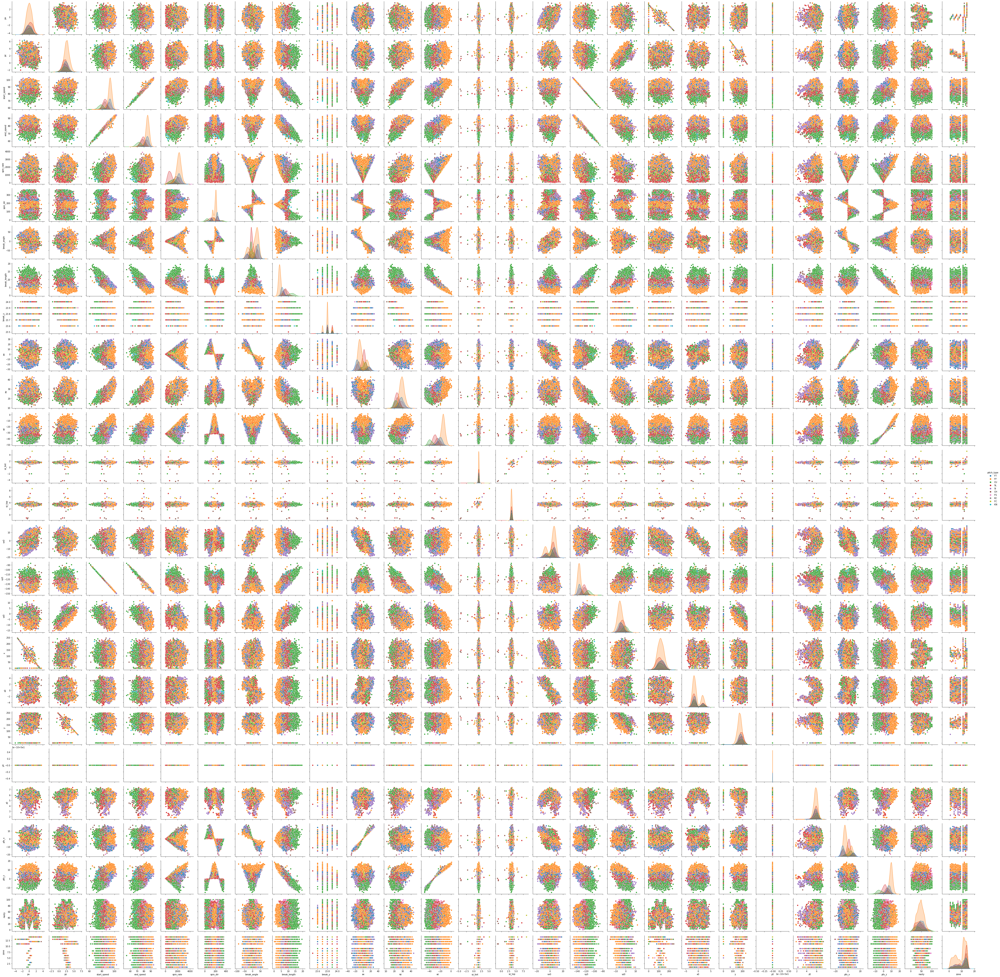

In [45]:

# make a pairplot of the subset of the data and use the pitch type as the hue
sns.pairplot(pitches_subset, hue="pitch_type")

The pairplot visualises the relationship between the features and the target variable. The diagonal plots show the distribution of the features. The scatter plots show the relationship between the features and the target variable. The scatter plots show that while some classes like the four-seam fastball (FF) and the curveball (CU) are linearly separable, some classes like the splitter (FS) and the sinker (SI) are not linearly separable. This is why the model is underperforming. A neural network model will be able to learn the non-linear relationships between the features and the target variable.

## Train Neural Network Model
We will use Google's TensorFlow library to build a neural network model. We will use the Sequential model to build the model. The Sequential model is a linear stack of layers. We will use the Dense layer to build the neural network layers. The Dense layer is a fully connected layer. We will use the ReLU activation function for the hidden layers and the softmax activation function for the output layer. The softmax activation function is used for multi-class classification problems. We will use the Adam optimizer to optimize the model. We will use the categorical_crossentropy loss function to compute the loss. We will use the accuracy metric to evaluate the model.

Since the output layer has 10 nodes, we will need to one-hot encode the target variable. We will use the to_categorical() function from the keras.utils module to one-hot encode the target variable.

In [46]:
pip install tensorflow --user

Note: you may need to restart the kernel to use updated packages.


In [47]:
# import tensorflow
import tensorflow as tf
# import keras
from tensorflow import keras

# To save computer resources, we will only use the under sampled data
# Transform the target variable into a one-hot encoded matrix 
y_train_rus_onehot = keras.utils.to_categorical(y_train_rus)

# transform the test set as well
y_test_onehot = keras.utils.to_categorical(y_test)

# print the shape of y_train_rus_onehot
print(y_train_rus_onehot.shape)

# instantiate the model

model = keras.Sequential([
    keras.layers.Dense(32, activation="relu", input_shape=(X_train_rus.shape[1],)),
    keras.layers.Dense(32, activation="relu"),
    keras.layers.Dense(10, activation="softmax")

])

# compile the model

model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

(90080, 10)


In [54]:
X_train_rus = np.asarray(X_train_rus).astype('float32')

X_test = np.asarray(X_test).astype('float32')

In [55]:
# fit the model

model.fit(X_train_rus, y_train_rus_onehot, epochs=10, batch_size=32)


Epoch 1/10
2815/2815 [==============================] - 2s 579us/step - loss: 4.4601 - accuracy: 0.3612
Epoch 2/10
2815/2815 [==============================] - 2s 564us/step - loss: 1.6819 - accuracy: 0.4633
Epoch 3/10
2815/2815 [==============================] - 2s 575us/step - loss: 1.3830 - accuracy: 0.5185
Epoch 4/10
2815/2815 [==============================] - 2s 566us/step - loss: 1.2049 - accuracy: 0.5519
Epoch 5/10
2815/2815 [==============================] - 2s 569us/step - loss: 1.1010 - accuracy: 0.5705
Epoch 6/10
2815/2815 [==============================] - 2s 569us/step - loss: 1.0124 - accuracy: 0.5830
Epoch 7/10
2815/2815 [==============================] - 2s 589us/step - loss: 0.9621 - accuracy: 0.5959
Epoch 8/10
2815/2815 [==============================] - 2s 571us/step - loss: 0.9262 - accuracy: 0.6094
Epoch 9/10
2815/2815 [==============================] - 2s 565us/step - loss: 0.9063 - accuracy: 0.6173
Epoch 10/10
2815/2815 [==============================] - 2s 568u

In [56]:
print("model accuracy on training set: ", model.evaluate(X_train_rus, y_train_rus_onehot)[1])

2815/2815 [==============================] - 2s 515us/step - loss: 0.8903 - accuracy: 0.6281
model accuracy on training set:  0.6280639171600342


In [57]:

# evaluate the model on the test set

print("Evaluate on test data")
print(model.evaluate(X_test, y_test_onehot))

# predict the test set

y_pred4 = model.predict(X_test)

# convert the predictions to the actual pitch types

y_pred4 = np.argmax(y_pred4, axis=1)

# get a confusion matrix

cf = confusion_matrix(y_test, y_pred4)

# change the labels to the pitch types 

cf = pd.DataFrame(cf, columns=le.classes_, index=le.classes_)

# get the classification report

clr = classification_report(y_test, y_pred4, output_dict=True)

# change the keys to the pitch types

clr = {le.classes_[int(k)] if k.isnumeric() else k : v for k, v in clr.items() }

# convert the classification report to a dataframe

clr = pd.DataFrame(clr)

# add a row for accuracy

clr["accuracy"] = [None,None,clr["accuracy"][0], None]

# transpose the dataframe

clr = clr.T



Evaluate on test data
17778/17778 [==============================] - 9s 521us/step - loss: 0.8862 - accuracy: 0.6320
[0.8862203359603882, 0.6319642663002014]
17778/17778 [==============================] - 8s 435us/step


In [58]:
cf

,CH,CU,FC,FF,FS,FT,KC,KN,SI,SL
CH,22261,102,687,1016,20401,751,43,548,12020,729
CU,68,27621,67,2,327,0,12334,834,7,5618
FC,114,27,20426,3227,474,14,90,8,333,5238
FF,492,0,7783,160133,464,14723,0,37,19213,130
FS,1039,72,106,92,5880,49,20,49,1119,315
FT,599,0,214,7006,554,22727,1,0,36471,25
KC,10,2860,35,1,69,0,8936,74,6,1306
KN,58,82,8,0,50,0,74,1925,0,55
SI,819,0,150,3819,775,8793,1,0,34121,23
SL,314,7038,17791,582,3072,4,5268,248,326,55473


In [59]:
clr

,precision,recall,f1-score,support
CH,0.863700,0.380153,0.527937,58558.0
CU,0.730676,0.589210,0.652362,46878.0
FC,0.432141,0.681981,0.529048,29951.0
FF,0.910478,0.788930,0.845357,202975.0
FS,0.183372,0.672692,0.288186,8741.0
FT,0.482926,0.336213,0.396431,67597.0
KC,0.333844,0.672031,0.446086,13297.0
KN,0.517056,0.854796,0.644351,2252.0
SI,0.329302,0.703511,0.448615,48501.0
SL,0.804983,0.615573,0.697651,90116.0


The first neural network fit had an input layer with 32 nodes, an hidden layer with 32 nodes, and the output layer with 10 nodes. The model was trained for 10 epochs. The model achieved an accuracy of 0.65 on the training set and 0.66 on the test set. This is a significant improvement over the logistic regression model.

From the confusion matrix and the classification report, it can be seen that the model is struggling to predict some classses. It is misclassifying the fastball (FF) and slider (SL) as cutter (FC); changeup (CH), sinker (SI), and slider (SL) as splitter (FS); curveball (CU) and slider (SL) as knuckle curve (KC); changeup (CH), curveball (CU), and slider (SL) as knuckleball (KN); and changeup (CH), two-seam fastball (FT), and four-seam fastball (FF) as sinker (SI). 

Now, let's retrain the model with more layers and more nodes.

## Retrain Neural Network Model

In [60]:
# retrian the neural network

# instantiate the model
model2 = keras.Sequential([
    keras.layers.Dense(128, activation="relu", input_shape=(X_train_rus.shape[1],)),
    # add normalisation layer
    keras.layers.BatchNormalization(),
    keras.layers.Dense(64, activation="relu"),
    # add dropout layer
    keras.layers.Dropout(0.3, seed=42),
    keras.layers.Dense(32, activation="relu"),

    # add regularisation layer
    keras.layers.Dense(32, activation="relu", kernel_regularizer=keras.regularizers.l2(0.001)),

    # add output layer
    keras.layers.Dense(10, activation="softmax")

])

# compile the model
model2.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])


In [61]:
# fit the model
model2.fit(X_train_rus, y_train_rus_onehot, epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
2252/2252 [==============================] - 2s 881us/step - loss: 0.9669 - accuracy: 0.6168 - val_loss: 15.5094 - val_accuracy: 0.0000e+00
Epoch 2/10
2252/2252 [==============================] - 2s 854us/step - loss: 0.7529 - accuracy: 0.6986 - val_loss: 15.4852 - val_accuracy: 0.0000e+00
Epoch 3/10
2252/2252 [==============================] - 2s 846us/step - loss: 0.7022 - accuracy: 0.7174 - val_loss: 21.7943 - val_accuracy: 0.0000e+00
Epoch 4/10
2252/2252 [==============================] - 2s 844us/step - loss: 0.6757 - accuracy: 0.7296 - val_loss: 20.3782 - val_accuracy: 0.0000e+00
Epoch 5/10
2252/2252 [==============================] - 2s 851us/step - loss: 0.6590 - accuracy: 0.7358 - val_loss: 21.9050 - val_accuracy: 0.0000e+00
Epoch 6/10
2252/2252 [==============================] - 2s 847us/step - loss: 0.6443 - accuracy: 0.7417 - val_loss: 23.1873 - val_accuracy: 0.0000e+00
Epoch 7/10
2252/2252 [==============================] - 2s 872us/step - loss: 0.6376 - accurac

In [62]:
model2.evaluate(X_train_rus, y_train_rus_onehot)

2815/2815 [==============================] - 2s 551us/step - loss: 6.5110 - accuracy: 0.6178


[6.5109686851501465, 0.6178286075592041]

In [63]:
model2.evaluate(X_test, y_test_onehot)

17778/17778 [==============================] - 10s 556us/step - loss: 7.7043 - accuracy: 0.5337


[7.704282760620117, 0.5337302684783936]

In [64]:

# using the oversampled data
# one-hot encode the target variable
y_train_sm_onehot = keras.utils.to_categorical(y_train_sm)


In [66]:
X_train_sm = np.asarray(X_train_sm).astype('float32')



In [67]:
# retrain model 1 with the oversampled data
model.fit(X_train_sm, y_train_sm_onehot, epochs=10, batch_size=128, validation_split=0.2)

Epoch 1/10
50744/50744 [==============================] - 36s 705us/step - loss: 0.7224 - accuracy: 0.7253 - val_loss: 1.2123 - val_accuracy: 0.4524
Epoch 2/10
50744/50744 [==============================] - 36s 707us/step - loss: 0.6841 - accuracy: 0.7401 - val_loss: 1.0191 - val_accuracy: 0.4951
Epoch 3/10
50744/50744 [==============================] - 37s 723us/step - loss: 0.6428 - accuracy: 0.7467 - val_loss: 1.0827 - val_accuracy: 0.4742
Epoch 4/10
50744/50744 [==============================] - 37s 720us/step - loss: 0.6625 - accuracy: 0.7550 - val_loss: 1.2597 - val_accuracy: 0.4824
Epoch 5/10
50744/50744 [==============================] - 35s 694us/step - loss: 0.6155 - accuracy: 0.7589 - val_loss: 1.1301 - val_accuracy: 0.5081
Epoch 6/10
50744/50744 [==============================] - 35s 689us/step - loss: 0.6095 - accuracy: 0.7607 - val_loss: 1.0989 - val_accuracy: 0.4929
Epoch 7/10
50744/50744 [==============================] - 34s 679us/step - loss: 0.6064 - accuracy: 0.7618

In [68]:
model.evaluate(X_train_sm, y_train_sm_onehot)

253720/253720 [==============================] - 128s 505us/step - loss: 0.7087 - accuracy: 0.7082


[0.7086564898490906, 0.7081613540649414]

In [69]:
model.evaluate(X_test, y_test_onehot)

17778/17778 [==============================] - 9s 505us/step - loss: 0.8072 - accuracy: 0.6755


[0.8071699738502502, 0.6755439639091492]

In [70]:
pd.DataFrame(confusion_matrix(y_test, y_pred4)
, columns=le.classes_, index=le.classes_)

,CH,CU,FC,FF,FS,FT,KC,KN,SI,SL
CH,22261,102,687,1016,20401,751,43,548,12020,729
CU,68,27621,67,2,327,0,12334,834,7,5618
FC,114,27,20426,3227,474,14,90,8,333,5238
FF,492,0,7783,160133,464,14723,0,37,19213,130
FS,1039,72,106,92,5880,49,20,49,1119,315
FT,599,0,214,7006,554,22727,1,0,36471,25
KC,10,2860,35,1,69,0,8936,74,6,1306
KN,58,82,8,0,50,0,74,1925,0,55
SI,819,0,150,3819,775,8793,1,0,34121,23
SL,314,7038,17791,582,3072,4,5268,248,326,55473


In [71]:
pd.DataFrame({le.classes_[int(k)] if k.isnumeric() else k : v for k, v in classification_report(y_test, y_pred4, output_dict=True)
.items() }).T

,precision,recall,f1-score,support
CH,0.863700,0.380153,0.527937,58558.000000
CU,0.730676,0.589210,0.652362,46878.000000
FC,0.432141,0.681981,0.529048,29951.000000
FF,0.910478,0.788930,0.845357,202975.000000
FS,0.183372,0.672692,0.288186,8741.000000
FT,0.482926,0.336213,0.396431,67597.000000
KC,0.333844,0.672031,0.446086,13297.000000
KN,0.517056,0.854796,0.644351,2252.000000
SI,0.329302,0.703511,0.448615,48501.000000
SL,0.804983,0.615573,0.697651,90116.000000


In [ ]:
# 